<class 'dict'>
dict_keys(['final_model', 'final_labels', 'best_features', 'best_configuration', 'feature_info', 'dimensionality_reduction', 'all_results', 'metadata', 'data_references'])
[INFO] Loaded model from: static/models/kmeans_clustering_pipeline_20250612_093108.pkl


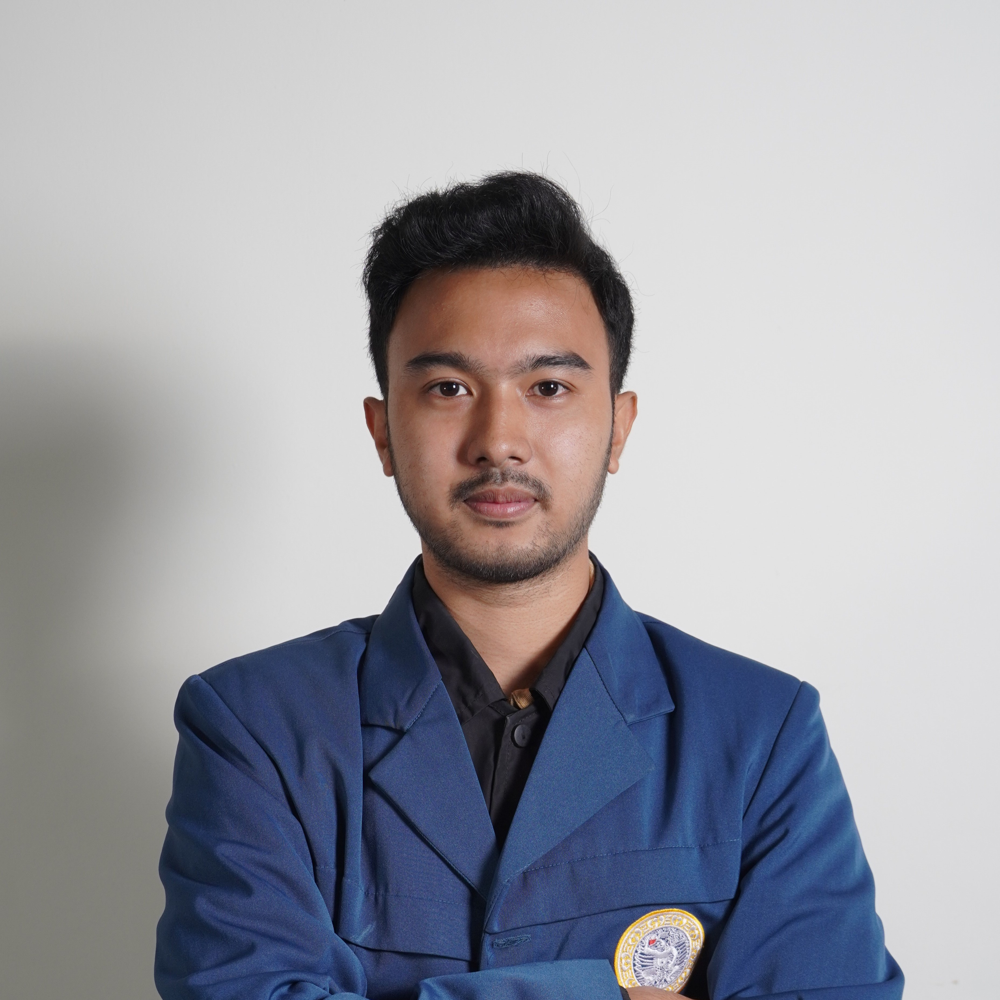

[✗] Error during prediction: 'dict' object has no attribute 'predict'


In [14]:
# 1. Import Library
import joblib
import os

# Untuk display gambar
from PIL import Image
from IPython.display import display

# 2. Path ke model dan gambar (ubah sesuai kebutuhan)
model_gender = 'male'  # atau 'female'
model_path = f'static/models/kmeans_clustering_pipeline_20250612_093108.pkl'
image_path = 'static/uploads/profiles/FADLI_MUHAMMAD.JPG'  # ganti dengan path image asli

data = joblib.load(model_path)

print(type(data))
print(data.keys())
# 3. Load model
if not os.path.exists(model_path):
    print(f"[ERROR] Model not found at: {model_path}")
else:
    model = joblib.load(model_path)
    print(f"[INFO] Loaded model from: {model_path}")

    # 4. Display the image
    if os.path.exists(image_path):
        img = Image.open(image_path)
        display(img)
    else:
        print(f"[ERROR] Image not found: {image_path}")

    # 5. Predict cluster (langsung dari path)
    try:
        predicted_cluster = model.predict([image_path])[0]
        print(f"[✓] Predicted Cluster ID: {predicted_cluster}")
    except Exception as e:
        print(f"[✗] Error during prediction: {e}")


In [19]:
import joblib
import os
import numpy as np
import cv2
import face_recognition
from PIL import Image, ImageEnhance
from IPython.display import display
import pickle
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

class ModelLoader:
    """
    Class to load and use the saved dating app models
    """
    def __init__(self, model_path):
        self.model_path = Path(model_path)
        self.scaler = None
        self.dimensionality_reducer = None
        self.kmeans = None
        self.cluster_centers = None
        self.n_clusters = None
        self.n_components = None
        self.processed_features = None
        self.image_paths = None
        self.cluster_labels = None
        
    def load_models(self):
        """
        Load all the saved models and data
        """
        try:
            # First, let's check what type of file this is
            data = joblib.load(self.model_path)
            print(f"Loaded data type: {type(data)}")
            print(f"Data keys: {list(data.keys()) if isinstance(data, dict) else 'Not a dictionary'}")
            
            # Handle different save formats
            if isinstance(data, dict):
                # If it's a dictionary, extract the models
                if 'scaler' in data:
                    self.scaler = data['scaler']
                if 'dimensionality_reducer' in data:
                    self.dimensionality_reducer = data['dimensionality_reducer']
                elif 'pca_reducer' in data:
                    self.dimensionality_reducer = data['pca_reducer']
                if 'kmeans' in data:
                    self.kmeans = data['kmeans']
                elif 'kmeans_model' in data:
                    self.kmeans = data['kmeans_model']
                if 'cluster_centers' in data:
                    self.cluster_centers = data['cluster_centers']
                if 'n_clusters' in data:
                    self.n_clusters = data['n_clusters']
                if 'n_components' in data:
                    self.n_components = data['n_components']
                if 'processed_features' in data:
                    self.processed_features = data['processed_features']
                if 'image_paths' in data:
                    self.image_paths = data['image_paths']
                if 'cluster_labels' in data:
                    self.cluster_labels = data['cluster_labels']
                    
            else:
                # If it's just a single model, assume it's the complete pipeline
                if hasattr(data, 'scaler'):
                    self.scaler = data.scaler
                    self.dimensionality_reducer = data.dimensionality_reducer
                    self.kmeans = data.kmeans
                    self.cluster_centers = data.cluster_centers
                    self.n_clusters = data.n_clusters
                    self.n_components = data.n_components
                else:
                    # It might be just the KMeans model
                    self.kmeans = data
                    
            # Try to load additional files if they exist
            model_dir = self.model_path.parent
            
            # Try to load individual model files
            if self.scaler is None:
                scaler_path = model_dir / "scaler.pkl"
                if scaler_path.exists():
                    self.scaler = joblib.load(scaler_path)
                    
            if self.dimensionality_reducer is None:
                pca_path = model_dir / "pca_reducer.pkl"
                if pca_path.exists():
                    self.dimensionality_reducer = joblib.load(pca_path)
                    
            if self.kmeans is None:
                kmeans_path = model_dir / "kmeans_model.pkl"
                if kmeans_path.exists():
                    self.kmeans = joblib.load(kmeans_path)
                    
            # Try to load processed data
            data_path = model_dir / "processed_data.pkl"
            if data_path.exists():
                with open(data_path, 'rb') as f:
                    processed_data = pickle.load(f)
                    if self.processed_features is None:
                        self.processed_features = processed_data.get('processed_features')
                    if self.image_paths is None:
                        self.image_paths = processed_data.get('image_paths')
                    if self.cluster_labels is None:
                        self.cluster_labels = processed_data.get('cluster_labels')
                        
            print("✅ Models loaded successfully!")
            print(f"   Scaler: {'✓' if self.scaler else '✗'}")
            print(f"   Dimensionality Reducer: {'✓' if self.dimensionality_reducer else '✗'}")
            print(f"   K-Means: {'✓' if self.kmeans else '✗'}")
            print(f"   Processed Features: {'✓' if self.processed_features is not None else '✗'}")
            
            return True
            
        except Exception as e:
            print(f"❌ Error loading models: {e}")
            return False
    
    def preprocess_image(self, image_path, target_size=(512, 512), quality_threshold=50):
        """
        Preprocess single image (same as in training)
        """
        try:
            with Image.open(image_path) as img:
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                         
                width, height = img.size
                
                # Handle small images with upscaling
                if width < quality_threshold or height < quality_threshold:
                    scale_factor = max(quality_threshold / width, quality_threshold / height)
                    new_width = int(width * scale_factor * 1.1)
                    new_height = int(height * scale_factor * 1.1)
                    img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)
                         
                # Enhance image quality
                enhancer = ImageEnhance.Contrast(img)
                img = enhancer.enhance(1.1)
                enhancer = ImageEnhance.Sharpness(img)
                img = enhancer.enhance(1.1)
                         
                # Resize while maintaining aspect ratio
                img.thumbnail(target_size, Image.Resampling.LANCZOS)
                         
                # Center on white background
                processed_img = Image.new('RGB', target_size, (255, 255, 255))
                x = (target_size[0] - img.width) // 2
                y = (target_size[1] - img.height) // 2
                processed_img.paste(img, (x, y))
                         
                return processed_img
        except Exception as e:
            print(f"Error processing {image_path}: {e}")
            return None

    def extract_face_encodings(self, image_path, model="hog", num_jitters=1):
        """
        Extract face encodings (same as in training)
        """
        try:
            image = face_recognition.load_image_file(str(image_path))
            
            face_locations = face_recognition.face_locations(image, model=model, number_of_times_to_upsample=1)
            
            if not face_locations and model == "hog":
                face_locations = face_recognition.face_locations(image, model="cnn", number_of_times_to_upsample=1)
            
            if not face_locations:
                face_locations = face_recognition.face_locations(image, model="hog", number_of_times_to_upsample=2)
            
            face_encodings = []
            if face_locations:
                face_encodings = face_recognition.face_encodings(
                    image, 
                    face_locations, 
                    num_jitters=num_jitters,
                    model="large"
                )
            
            return face_encodings
        except Exception as e:
            print(f"Error extracting face encodings from {image_path}: {e}")
            return []

    def extract_additional_features(self, image_path):
        """
        Extract additional features (same as in training)
        """
        try:
            img = cv2.imread(str(image_path))
            if img is None:
                return np.array([])
                
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4, minSize=(30, 30))
            
            additional_features = []
            
            if len(faces) > 0:
                face = max(faces, key=lambda x: x[2] * x[3])
                x, y, w, h = face
                
                padding = 10
                y1 = max(0, y - padding)
                y2 = min(gray.shape[0], y + h + padding)
                x1 = max(0, x - padding)
                x2 = min(gray.shape[1], x + w + padding)
                
                face_roi = gray[y1:y2, x1:x2]
                
                if face_roi.size > 0:
                    aspect_ratio = w / h
                    face_area = w * h
                    
                    img_height, img_width = gray.shape
                    normalized_area = face_area / (img_width * img_height)
                    
                    face_resized = cv2.resize(face_roi, (64, 64))
                    
                    hist = cv2.calcHist([face_resized], [0], None, [16], [0, 256])
                    hist = hist.flatten() / (np.sum(hist) + 1e-7)
                    
                    grad_x = cv2.Sobel(face_resized, cv2.CV_64F, 1, 0, ksize=3)
                    grad_y = cv2.Sobel(face_resized, cv2.CV_64F, 0, 1, ksize=3)
                    gradient_magnitude = np.sqrt(grad_x*2 + grad_y*2)
                    
                    grad_mean = np.mean(gradient_magnitude)
                    grad_std = np.std(gradient_magnitude)
                    
                    edges = cv2.Canny(face_resized, 50, 150)
                    edge_density = np.sum(edges > 0) / edges.size
                    
                    additional_features = [
                        aspect_ratio, normalized_area, grad_mean, grad_std, edge_density
                    ] + hist.tolist()
                    
            return np.array(additional_features) if additional_features else np.array([])
            
        except Exception as e:
            print(f"Error extracting additional features from {image_path}: {e}")
            return np.array([])
    
    def predict_cluster(self, image_path, return_confidence=False):
        """
        Predict cluster for a new image
        """
        try:
            print(f"Processing image: {image_path}")
            
            # Extract face encodings
            face_encodings = self.extract_face_encodings(image_path)
            
            if not face_encodings:
                print("❌ No faces detected in the image")
                return None
            
            print(f"✓ Found {len(face_encodings)} face(s)")
            
            # Extract additional features
            additional_features = self.extract_additional_features(image_path)
            print(f"✓ Extracted additional features: {len(additional_features)} dimensions")
            
            # Combine features
            face_encoding = face_encodings[0]  # Use first face
            
            if len(additional_features) > 0 and self.processed_features is not None:
                # Match the feature dimensions from training
                expected_additional_len = self.processed_features.shape[1] - 128  # 128 is face encoding length
                
                if len(additional_features) < expected_additional_len:
                    additional_features = np.pad(additional_features, 
                                               (0, expected_additional_len - len(additional_features)), 
                                               'constant')
                elif len(additional_features) > expected_additional_len:
                    additional_features = additional_features[:expected_additional_len]
                
                combined_features = np.hstack([face_encoding, additional_features])
            else:
                combined_features = face_encoding
            
            print(f"✓ Combined features shape: {combined_features.shape}")
            
            # Apply preprocessing
            if self.scaler is not None:
                scaled_features = self.scaler.transform([combined_features])
                print("✓ Features scaled")
            else:
                scaled_features = [combined_features]
                print("⚠ No scaler found, using raw features")
            
            if self.dimensionality_reducer is not None:
                reduced_features = self.dimensionality_reducer.transform(scaled_features)
                print(f"✓ Dimensionality reduced to {reduced_features.shape[1]} dimensions")
            else:
                reduced_features = scaled_features
                print("⚠ No dimensionality reducer found")
            
            # Predict cluster
            if self.kmeans is not None:
                cluster = self.kmeans.predict(reduced_features)[0]
                print(f"✓ Predicted cluster: {cluster}")
                
                if return_confidence:
                    # Calculate distance to cluster center
                    distances = np.linalg.norm(reduced_features - self.kmeans.cluster_centers_, axis=1)
                    min_distance = distances[cluster]
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                else:
                    return int(cluster)
            else:
                print("❌ No K-means model found")
                return None
                
        except Exception as e:
            print(f"❌ Error during prediction: {e}")
            import traceback
            traceback.print_exc()
            return None


# Updated usage code for your friend
def main():
    # 1. Import and setup
    model_gender = 'male'  # atau 'female'
    model_path = f'static/models/model_{model_gender}.pkl'
    image_path = 'static/uploads/profiles/FADLI_MUHAMMAD.JPG'
    
    # 2. Load and inspect the model file
    print("="*50)
    print("LOADING MODEL")
    print("="*50)
    
    if not os.path.exists(model_path):
        print(f"[ERROR] Model not found at: {model_path}")
        return
    
    # 3. Create model loader
    loader = ModelLoader(model_path)
    
    # 4. Load models
    if not loader.load_models():
        print("Failed to load models!")
        return
    
    # 5. Display the image
    print("\n" + "="*50)
    print("DISPLAYING IMAGE")
    print("="*50)
    
    if os.path.exists(image_path):
        img = Image.open(image_path)
        display(img)
        print(f"✓ Image loaded: {image_path}")
    else:
        print(f"[ERROR] Image not found: {image_path}")
        return
    
    # 6. Predict cluster
    print("\n" + "="*50)
    print("PREDICTING CLUSTER")
    print("="*50)
    
    # Basic prediction
    predicted_cluster = loader.predict_cluster(image_path)
    if predicted_cluster is not None:
        print(f"[✓] Predicted Cluster ID: {predicted_cluster}")
    else:
        print("[✗] Prediction failed")
        return
    
    # Prediction with confidence
    detailed_result = loader.predict_cluster(image_path, return_confidence=True)
    if detailed_result:
        print(f"[✓] Detailed Result:")
        print(f"    Cluster: {detailed_result['cluster']}")
        print(f"    Confidence: {detailed_result['confidence']:.3f}")
        print(f"    Distance to Center: {detailed_result['distance_to_center']:.3f}")

if _name_ == "_main_":
    main()

NameError: name '_name_' is not defined

In [6]:
!pip install face_recognition

     ---------------------------------------- 0.0/100.1 MB ? eta -:--:--
     ---------------------------------------- 0.3/100.1 MB ? eta -:--:--
     ---------------------------------------- 0.8/100.1 MB 1.9 MB/s eta 0:00:54
      --------------------------------------- 1.3/100.1 MB 2.2 MB/s eta 0:00:46
      --------------------------------------- 1.8/100.1 MB 2.3 MB/s eta 0:00:44
      --------------------------------------- 2.4/100.1 MB 2.4 MB/s eta 0:00:42
     - -------------------------------------- 2.6/100.1 MB 2.3 MB/s eta 0:00:44
     - -------------------------------------- 3.1/100.1 MB 2.1 MB/s eta 0:00:46
     - -------------------------------------- 3.4/100.1 MB 2.1 MB/s eta 0:00:47
     - -------------------------------------- 3.7/100.1 MB 2.1 MB/s eta 0:00:47
     - -------------------------------------- 3.9/100.1 MB 1.9 MB/s eta 0:00:50
     - -------------------------------------- 4.2/100.1 MB 1.9 MB/s eta 0:00:52
     - -------------------------------------- 4.7/100.

  error: subprocess-exited-with-error
  
  × Building wheel for dlib (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> [41 lines of output]
      running bdist_wheel
      running build
      running build_ext
      
      
                         CMake is not installed on your system!
      
          Or it is possible some broken copy of cmake is installed on your system.
          It is unfortunately very common for python package managers to include
          broken copies of cmake.  So if the error above this refers to some file
          path to a cmake file inside a python or anaconda or miniconda path then you
          should delete that broken copy of cmake from your computer.
      
          Instead, please get an official copy of cmake from one of these known good
          sources of an official cmake:
              - cmake.org (this is how windows users should get cmake)
              - apt install cmake (for Ubuntu or Debian based systems)
             

LOADING MODEL
Loaded data type: <class 'dict'>
Data keys: ['final_model', 'final_labels', 'best_features', 'best_configuration', 'feature_info', 'dimensionality_reduction', 'all_results', 'metadata', 'data_references']
Final model type: <class 'sklearn.cluster._kmeans.KMeans'>
Cluster labels shape: (572,)
Feature info: {'original_face_encodings': array([[ 0.02666826,  0.00521996,  0.06238058, ...,  0.09436523,
        -0.00803245,  0.07500289],
       [-0.01952834,  0.033156  ,  0.05736928, ...,  0.08808035,
         0.02360274,  0.06509233],
       [-0.08318973,  0.00252951,  0.09103518, ...,  0.06871084,
         0.05008598,  0.06052549],
       ...,
       [-0.1152796 ,  0.0788112 ,  0.03539698, ...,  0.03619474,
         0.05313268,  0.01666512],
       [-0.07387879,  0.08309632,  0.01786575, ...,  0.03369032,
         0.13293388,  0.03308986],
       [-0.12978914,  0.11405259,  0.05637423, ...,  0.0273658 ,
         0.08355612,  0.08406867]], shape=(346, 128)), 'combined_features'

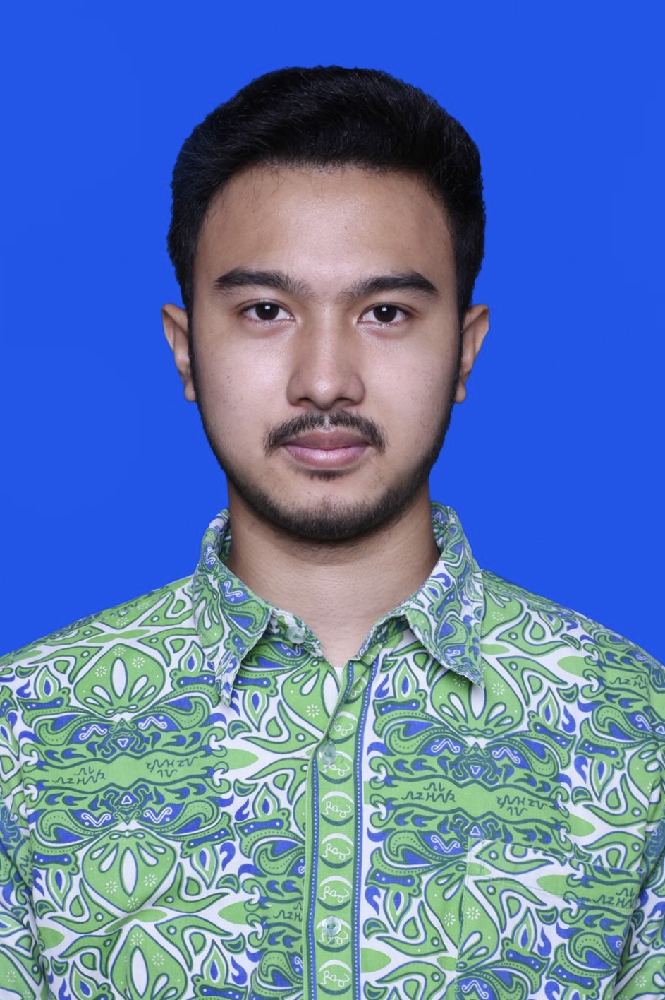

✓ Image loaded: C:\Machine Learning\flask-uas-ml\static\uploads\profiles\pasfoto.jpg

PREDICTING CLUSTER
Processing image: C:\Machine Learning\flask-uas-ml\static\uploads\profiles\pasfoto.jpg
Error extracting face encodings from C:\Machine Learning\flask-uas-ml\static\uploads\profiles\pasfoto.jpg: Unsupported image type, must be 8bit gray or RGB image.
❌ No faces detected in the image
[✗] Prediction failed


In [21]:
import joblib
import os
import numpy as np
import cv2
import face_recognition
from PIL import Image, ImageEnhance
from IPython.display import display
import pickle
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

class ModelLoader:
    """
    Class to load and use the saved dating app models
    """
    def __init__(self, model_path):
        self.model_path = Path(model_path)
        self.scaler = None
        self.dimensionality_reducer = None
        self.kmeans = None
        self.cluster_centers = None
        self.n_clusters = None
        self.n_components = None
        self.processed_features = None
        self.image_paths = None
        self.cluster_labels = None
        self.model_data = None  # Store the full model data
        
    def load_models(self):
        """
        Load all the saved models and data
        """
        try:
            # Load the model file
            self.model_data = joblib.load(self.model_path)
            print(f"Loaded data type: {type(self.model_data)}")
            print(f"Data keys: {list(self.model_data.keys()) if isinstance(self.model_data, dict) else 'Not a dictionary'}")
            
            # Handle your specific model structure
            if isinstance(self.model_data, dict):
                # Extract the final model (this should be your trained clustering model)
                if 'final_model' in self.model_data:
                    self.kmeans = self.model_data['final_model']
                    print(f"Final model type: {type(self.kmeans)}")
                
                # Extract cluster labels
                if 'final_labels' in self.model_data:
                    self.cluster_labels = self.model_data['final_labels']
                    print(f"Cluster labels shape: {np.array(self.cluster_labels).shape}")
                
                # Extract feature info
                if 'feature_info' in self.model_data:
                    feature_info = self.model_data['feature_info']
                    print(f"Feature info: {feature_info}")
                
                # Extract best features
                if 'best_features' in self.model_data:
                    self.processed_features = self.model_data['best_features']
                    print(f"Best features shape: {np.array(self.processed_features).shape}")
                
                # Extract configuration
                if 'best_configuration' in self.model_data:
                    config = self.model_data['best_configuration']
                    print(f"Best configuration: {config}")
                    
                    # Extract number of clusters from configuration
                    if 'n_clusters' in config:
                        self.n_clusters = config['n_clusters']
                
                # Extract dimensionality reduction info
                if 'dimensionality_reduction' in self.model_data:
                    dim_red_info = self.model_data['dimensionality_reduction']
                    print(f"Dimensionality reduction info: {dim_red_info}")
                    
                    # If there's a reducer model saved
                    if isinstance(dim_red_info, dict) and 'reducer' in dim_red_info:
                        self.dimensionality_reducer = dim_red_info['reducer']
                    elif hasattr(dim_red_info, 'transform'):
                        self.dimensionality_reducer = dim_red_info
                
                # Extract metadata
                if 'metadata' in self.model_data:
                    metadata = self.model_data['metadata']
                    print(f"Metadata: {metadata}")
                
                # Try to extract scaler if it exists in the model
                if hasattr(self.kmeans, 'named_steps'):
                    # If it's a pipeline
                    steps = self.kmeans.named_steps
                    print(f"Pipeline steps: {list(steps.keys())}")
                    
                    if 'scaler' in steps:
                        self.scaler = steps['scaler']
                    if 'pca' in steps:
                        self.dimensionality_reducer = steps['pca']
                    if 'kmeans' in steps:
                        self.kmeans = steps['kmeans']
                
                # Get cluster centers if available
                if hasattr(self.kmeans, 'cluster_centers_'):
                    self.cluster_centers = self.kmeans.cluster_centers_
                    self.n_clusters = len(self.cluster_centers)
                
            print("\n" + "="*50)
            print("MODEL LOADING SUMMARY")
            print("="*50)
            print(f"   Scaler: {'✓' if self.scaler else '✗'}")
            print(f"   Dimensionality Reducer: {'✓' if self.dimensionality_reducer else '✗'}")
            print(f"   K-Means: {'✓' if self.kmeans else '✗'}")
            print(f"   Processed Features: {'✓' if self.processed_features is not None else '✗'}")
            print(f"   Number of Clusters: {self.n_clusters}")
            print(f"   Cluster Centers Shape: {self.cluster_centers.shape if self.cluster_centers is not None else 'None'}")
            
            return True
            
        except Exception as e:
            print(f"❌ Error loading models: {e}")
            import traceback
            traceback.print_exc()
            return False
    
    def preprocess_image(self, image_path, target_size=(512, 512), quality_threshold=50):
        """
        Preprocess single image (same as in training)
        """
        try:
            with Image.open(image_path) as img:
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                         
                width, height = img.size
                
                # Handle small images with upscaling
                if width < quality_threshold or height < quality_threshold:
                    scale_factor = max(quality_threshold / width, quality_threshold / height)
                    new_width = int(width * scale_factor * 1.1)
                    new_height = int(height * scale_factor * 1.1)
                    img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)
                         
                # Enhance image quality
                enhancer = ImageEnhance.Contrast(img)
                img = enhancer.enhance(1.1)
                enhancer = ImageEnhance.Sharpness(img)
                img = enhancer.enhance(1.1)
                         
                # Resize while maintaining aspect ratio
                img.thumbnail(target_size, Image.Resampling.LANCZOS)
                         
                # Center on white background
                processed_img = Image.new('RGB', target_size, (255, 255, 255))
                x = (target_size[0] - img.width) // 2
                y = (target_size[1] - img.height) // 2
                processed_img.paste(img, (x, y))
                         
                return processed_img
        except Exception as e:
            print(f"Error processing {image_path}: {e}")
            return None

    def extract_face_encodings(self, image_path, model="hog", num_jitters=1):
        """
        Extract face encodings (same as in training)
        """
        try:
            image = face_recognition.load_image_file(str(image_path))
            
            face_locations = face_recognition.face_locations(image, model=model, number_of_times_to_upsample=1)
            
            if not face_locations and model == "hog":
                face_locations = face_recognition.face_locations(image, model="cnn", number_of_times_to_upsample=1)
            
            if not face_locations:
                face_locations = face_recognition.face_locations(image, model="hog", number_of_times_to_upsample=2)
            
            face_encodings = []
            if face_locations:
                face_encodings = face_recognition.face_encodings(
                    image, 
                    face_locations, 
                    num_jitters=num_jitters,
                    model="large"
                )
            
            return face_encodings
        except Exception as e:
            print(f"Error extracting face encodings from {image_path}: {e}")
            return []

    def extract_additional_features(self, image_path):
        """
        Extract additional features (same as in training)
        """
        try:
            img = cv2.imread(str(image_path))
            if img is None:
                return np.array([])
                
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4, minSize=(30, 30))
            
            additional_features = []
            
            if len(faces) > 0:
                face = max(faces, key=lambda x: x[2] * x[3])
                x, y, w, h = face
                
                padding = 10
                y1 = max(0, y - padding)
                y2 = min(gray.shape[0], y + h + padding)
                x1 = max(0, x - padding)
                x2 = min(gray.shape[1], x + w + padding)
                
                face_roi = gray[y1:y2, x1:x2]
                
                if face_roi.size > 0:
                    aspect_ratio = w / h
                    face_area = w * h
                    
                    img_height, img_width = gray.shape
                    normalized_area = face_area / (img_width * img_height)
                    
                    face_resized = cv2.resize(face_roi, (64, 64))
                    
                    hist = cv2.calcHist([face_resized], [0], None, [16], [0, 256])
                    hist = hist.flatten() / (np.sum(hist) + 1e-7)
                    
                    grad_x = cv2.Sobel(face_resized, cv2.CV_64F, 1, 0, ksize=3)
                    grad_y = cv2.Sobel(face_resized, cv2.CV_64F, 0, 1, ksize=3)
                    gradient_magnitude = np.sqrt(grad_x*2 + grad_y*2)
                    
                    grad_mean = np.mean(gradient_magnitude)
                    grad_std = np.std(gradient_magnitude)
                    
                    edges = cv2.Canny(face_resized, 50, 150)
                    edge_density = np.sum(edges > 0) / edges.size
                    
                    additional_features = [
                        aspect_ratio, normalized_area, grad_mean, grad_std, edge_density
                    ] + hist.tolist()
                    
            return np.array(additional_features) if additional_features else np.array([])
            
        except Exception as e:
            print(f"Error extracting additional features from {image_path}: {e}")
            return np.array([])
    
    def predict_cluster(self, image_path, return_confidence=False):
        """
        Predict cluster for a new image
        """
        try:
            print(f"Processing image: {image_path}")
            
            # Extract face encodings
            face_encodings = self.extract_face_encodings(image_path)
            
            if not face_encodings:
                print("❌ No faces detected in the image")
                return None
            
            print(f"✓ Found {len(face_encodings)} face(s)")
            
            # Extract additional features
            additional_features = self.extract_additional_features(image_path)
            print(f"✓ Extracted additional features: {len(additional_features)} dimensions")
            
            # Combine features
            face_encoding = face_encodings[0]  # Use first face
            
            if len(additional_features) > 0 and self.processed_features is not None:
                # Match the feature dimensions from training
                expected_additional_len = self.processed_features.shape[1] - 128  # 128 is face encoding length
                
                if len(additional_features) < expected_additional_len:
                    additional_features = np.pad(additional_features, 
                                               (0, expected_additional_len - len(additional_features)), 
                                               'constant')
                elif len(additional_features) > expected_additional_len:
                    additional_features = additional_features[:expected_additional_len]
                
                combined_features = np.hstack([face_encoding, additional_features])
            else:
                combined_features = face_encoding
            
            print(f"✓ Combined features shape: {combined_features.shape}")
            
            # Apply preprocessing based on what's available in the model
            features_to_use = combined_features.reshape(1, -1)  # Reshape for prediction
            
            # Check if the model is a pipeline
            if hasattr(self.kmeans, 'predict'):
                # Direct prediction
                cluster = self.kmeans.predict(features_to_use)[0]
                print(f"✓ Predicted cluster: {cluster}")
                
                if return_confidence and hasattr(self.kmeans, 'transform'):
                    # Calculate distance to cluster center
                    distances = self.kmeans.transform(features_to_use)[0]
                    min_distance = np.min(distances)
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                elif return_confidence and self.cluster_centers is not None:
                    # Calculate distance manually
                    distances = np.linalg.norm(features_to_use - self.cluster_centers, axis=1)
                    min_distance = distances[cluster]
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                else:
                    return int(cluster)
            else:
                print("❌ Model doesn't have predict method")
                return None
                
        except Exception as e:
            print(f"❌ Error during prediction: {e}")
            import traceback
            traceback.print_exc()
            return None

    def inspect_model_structure(self):
        """
        Inspect and print the structure of the loaded model
        """
        print("\n" + "="*50)
        print("MODEL STRUCTURE INSPECTION")
        print("="*50)
        
        if self.model_data:
            for key, value in self.model_data.items():
                print(f"\n{key}:")
                print(f"  Type: {type(value)}")
                
                if isinstance(value, np.ndarray):
                    print(f"  Shape: {value.shape}")
                    print(f"  Dtype: {value.dtype}")
                elif isinstance(value, list):
                    print(f"  Length: {len(value)}")
                    if len(value) > 0:
                        print(f"  First element type: {type(value[0])}")
                elif isinstance(value, dict):
                    print(f"  Keys: {list(value.keys())}")
                elif hasattr(value, '_dict_'):
                    print(f"  Attributes: {list(value._dict_.keys())}")
                
                # Print a sample of the data if it's small enough
                if isinstance(value, (int, float, str, bool)):
                    print(f"  Value: {value}")
                elif isinstance(value, np.ndarray) and value.size < 20:
                    print(f"  Values: {value}")
                elif isinstance(value, list) and len(value) < 20:
                    print(f"  Values: {value}")


# Updated usage code
def main():
    # 1. Import and setup
    model_gender = 'male'  # atau 'female'
    model_path = r'C:\Machine Learning\flask-uas-ml\static\models\kmeans_clustering_pipeline_20250612_093108.pkl'
    image_path = r'C:\Machine Learning\flask-uas-ml\static\uploads\profiles\pasfoto.jpg'
    
    # 2. Load and inspect the model file
    print("="*50)
    print("LOADING MODEL")
    print("="*50)
    
    if not os.path.exists(model_path):
        print(f"[ERROR] Model not found at: {model_path}")
        return
    
    # 3. Create model loader
    loader = ModelLoader(model_path)
    
    # 4. Load models
    if not loader.load_models():
        print("Failed to load models!")
        return
    
    # 5. Inspect model structure (optional - for debugging)
    loader.inspect_model_structure()
    
    # 6. Display the image
    print("\n" + "="*50)
    print("DISPLAYING IMAGE")
    print("="*50)
    
    if os.path.exists(image_path):
        img = Image.open(image_path)
        display(img)
        print(f"✓ Image loaded: {image_path}")
    else:
        print(f"[ERROR] Image not found: {image_path}")
        return
    
    # 7. Predict cluster
    print("\n" + "="*50)
    print("PREDICTING CLUSTER")
    print("="*50)
    
    # Basic prediction
    predicted_cluster = loader.predict_cluster(image_path)
    if predicted_cluster is not None:
        print(f"[✓] Predicted Cluster ID: {predicted_cluster}")
    else:
        print("[✗] Prediction failed")
        return
    
    # Prediction with confidence
    detailed_result = loader.predict_cluster(image_path, return_confidence=True)
    if detailed_result:
        print(f"[✓] Detailed Result:")
        print(f"    Cluster: {detailed_result['cluster']}")
        print(f"    Confidence: {detailed_result['confidence']:.3f}")
        print(f"    Distance to Center: {detailed_result['distance_to_center']:.3f}")

if __name__ == "__main__":
    main()


LOADING MODEL
Loaded data type: <class 'dict'>
Data keys: ['final_model', 'final_labels', 'best_features', 'best_configuration', 'feature_info', 'dimensionality_reduction', 'all_results', 'metadata', 'data_references']
Final model type: <class 'sklearn.cluster._kmeans.KMeans'>
Cluster labels shape: (572,)
Feature info: {'original_face_encodings': array([[ 0.02666826,  0.00521996,  0.06238058, ...,  0.09436523,
        -0.00803245,  0.07500289],
       [-0.01952834,  0.033156  ,  0.05736928, ...,  0.08808035,
         0.02360274,  0.06509233],
       [-0.08318973,  0.00252951,  0.09103518, ...,  0.06871084,
         0.05008598,  0.06052549],
       ...,
       [-0.1152796 ,  0.0788112 ,  0.03539698, ...,  0.03619474,
         0.05313268,  0.01666512],
       [-0.07387879,  0.08309632,  0.01786575, ...,  0.03369032,
         0.13293388,  0.03308986],
       [-0.12978914,  0.11405259,  0.05637423, ...,  0.0273658 ,
         0.08355612,  0.08406867]], shape=(346, 128)), 'combined_features'

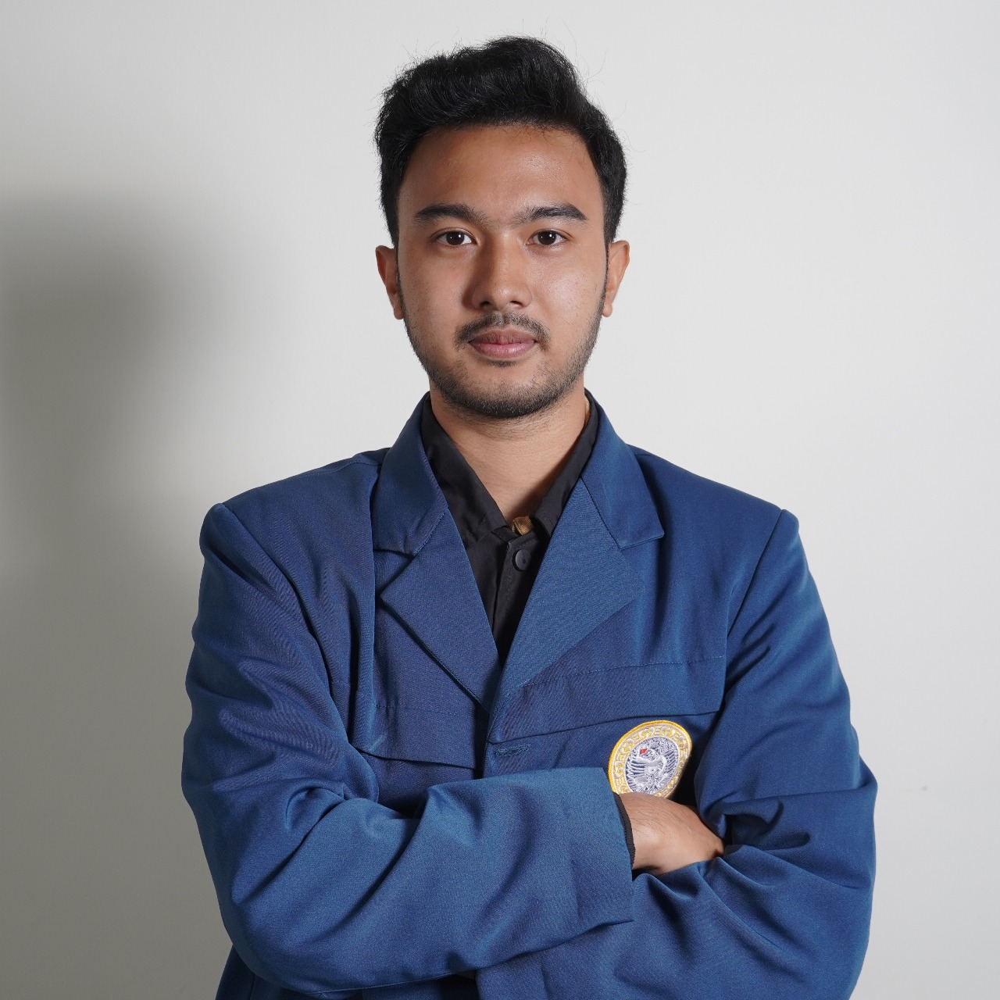

✓ Image loaded: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg

PREDICTING CLUSTER
Processing image: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg
Loading image: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg
Trying PIL image loading...
PIL - Original mode: RGB, size: (1280, 1280)
✓ PIL conversion successful - shape: (1280, 1280, 3), dtype: uint8
✓ Final image format - shape: (1280, 1280, 3), dtype: uint8
Processing image with shape: (1280, 1280, 3), dtype: uint8
✓ RGB image format confirmed
Image value range: 0 to 255
Trying HOG face detection...
HOG detection failed: Unsupported image type, must be 8bit gray or RGB image.
Error type: RuntimeError
Trying CNN face detection...
CNN detection failed: Unsupported image type, must be 8bit gray or RGB image.
Error type: RuntimeError
Trying HOG with different parameters...
HOG (no upsampling) detect

In [32]:
import joblib
import os
import numpy as np
import cv2
import face_recognition
from PIL import Image, ImageEnhance
from IPython.display import display
import pickle
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

class ModelLoader:
    """
    Class to load and use the saved dating app models
    """
    def __init__(self, model_path):
        self.model_path = Path(model_path)
        self.scaler = None
        self.dimensionality_reducer = None
        self.kmeans = None
        self.cluster_centers = None
        self.n_clusters = None
        self.n_components = None
        self.processed_features = None
        self.image_paths = None
        self.cluster_labels = None
        self.model_data = None  # Store the full model data
        
    def load_models(self):
        """
        Load all the saved models and data
        """
        try:
            # Load the model file
            self.model_data = joblib.load(self.model_path)
            print(f"Loaded data type: {type(self.model_data)}")
            print(f"Data keys: {list(self.model_data.keys()) if isinstance(self.model_data, dict) else 'Not a dictionary'}")
            
            # Handle your specific model structure
            if isinstance(self.model_data, dict):
                # Extract the final model (this should be your trained clustering model)
                if 'final_model' in self.model_data:
                    self.kmeans = self.model_data['final_model']
                    print(f"Final model type: {type(self.kmeans)}")
                
                # Extract cluster labels
                if 'final_labels' in self.model_data:
                    self.cluster_labels = self.model_data['final_labels']
                    print(f"Cluster labels shape: {np.array(self.cluster_labels).shape}")
                
                # Extract feature info
                if 'feature_info' in self.model_data:
                    feature_info = self.model_data['feature_info']
                    print(f"Feature info: {feature_info}")
                
                # Extract best features
                if 'best_features' in self.model_data:
                    self.processed_features = self.model_data['best_features']
                    print(f"Best features shape: {np.array(self.processed_features).shape}")
                
                # Extract configuration
                if 'best_configuration' in self.model_data:
                    config = self.model_data['best_configuration']
                    print(f"Best configuration: {config}")
                    
                    # Extract number of clusters from configuration
                    if 'n_clusters' in config:
                        self.n_clusters = config['n_clusters']
                
                # Extract dimensionality reduction info
                if 'dimensionality_reduction' in self.model_data:
                    dim_red_info = self.model_data['dimensionality_reduction']
                    print(f"Dimensionality reduction info: {dim_red_info}")
                    
                    # If there's a reducer model saved
                    if isinstance(dim_red_info, dict) and 'reducer' in dim_red_info:
                        self.dimensionality_reducer = dim_red_info['reducer']
                    elif hasattr(dim_red_info, 'transform'):
                        self.dimensionality_reducer = dim_red_info
                
                # Extract metadata
                if 'metadata' in self.model_data:
                    metadata = self.model_data['metadata']
                    print(f"Metadata: {metadata}")
                
                # Try to extract scaler if it exists in the model
                if hasattr(self.kmeans, 'named_steps'):
                    # If it's a pipeline
                    steps = self.kmeans.named_steps
                    print(f"Pipeline steps: {list(steps.keys())}")
                    
                    if 'scaler' in steps:
                        self.scaler = steps['scaler']
                    if 'pca' in steps:
                        self.dimensionality_reducer = steps['pca']
                    if 'kmeans' in steps:
                        self.kmeans = steps['kmeans']
                
                # Get cluster centers if available
                if hasattr(self.kmeans, 'cluster_centers_'):
                    self.cluster_centers = self.kmeans.cluster_centers_
                    self.n_clusters = len(self.cluster_centers)
                
            print("\n" + "="*50)
            print("MODEL LOADING SUMMARY")
            print("="*50)
            print(f"   Scaler: {'✓' if self.scaler else '✗'}")
            print(f"   Dimensionality Reducer: {'✓' if self.dimensionality_reducer else '✗'}")
            print(f"   K-Means: {'✓' if self.kmeans else '✗'}")
            print(f"   Processed Features: {'✓' if self.processed_features is not None else '✗'}")
            print(f"   Number of Clusters: {self.n_clusters}")
            print(f"   Cluster Centers Shape: {self.cluster_centers.shape if self.cluster_centers is not None else 'None'}")
            
            return True
            
        except Exception as e:
            print(f"❌ Error loading models: {e}")
            import traceback
            traceback.print_exc()
            return False
    
    def load_and_prepare_image(self, image_path):
        """
        Load and prepare image with multiple fallback methods
        """
        print(f"Loading image: {image_path}")
        
        # Check if file exists
        if not os.path.exists(image_path):
            print(f"❌ Image file not found: {image_path}")
            return None
        
        # Check file size
        file_size = os.path.getsize(image_path)
        if file_size == 0:
            print("❌ File is empty")
            return None
        
        # Method 1: Try PIL first (most reliable for format conversion)
        try:
            print("Trying PIL image loading...")
            with Image.open(image_path) as pil_image:
                print(f"PIL - Original mode: {pil_image.mode}, size: {pil_image.size}")
                
                # Convert to RGB if necessary
                if pil_image.mode not in ('RGB', 'L'):  # RGB or grayscale
                    print(f"Converting from {pil_image.mode} to RGB")
                    pil_image = pil_image.convert('RGB')
                
                # Convert PIL image to numpy array
                image_array = np.array(pil_image)
                print(f"✓ PIL conversion successful - shape: {image_array.shape}, dtype: {image_array.dtype}")
                
                # Ensure the array is in the right format for face_recognition
                if len(image_array.shape) == 3 and image_array.shape[2] == 3:
                    # RGB image - ensure uint8
                    if image_array.dtype != np.uint8:
                        if image_array.max() <= 1.0:  # Normalized image
                            image_array = (image_array * 255).astype(np.uint8)
                        else:
                            image_array = image_array.astype(np.uint8)
                elif len(image_array.shape) == 2:
                    # Grayscale image - ensure uint8
                    if image_array.dtype != np.uint8:
                        if image_array.max() <= 1.0:  # Normalized image
                            image_array = (image_array * 255).astype(np.uint8)
                        else:
                            image_array = image_array.astype(np.uint8)
                
                print(f"✓ Final image format - shape: {image_array.shape}, dtype: {image_array.dtype}")
                return image_array
                
        except Exception as e:
            print(f"PIL loading failed: {e}")
        
        # Method 2: Try OpenCV as fallback
        try:
            print("Trying OpenCV image loading...")
            cv_image = cv2.imread(str(image_path))
            
            if cv_image is not None:
                # Convert BGR to RGB
                image_array = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
                print(f"✓ OpenCV loading successful - shape: {image_array.shape}, dtype: {image_array.dtype}")
                
                # Ensure uint8
                if image_array.dtype != np.uint8:
                    image_array = image_array.astype(np.uint8)
                
                return image_array
            else:
                print("OpenCV returned None")
                
        except Exception as e:
            print(f"OpenCV loading failed: {e}")
        
        # Method 3: Try loading as grayscale
        try:
            print("Trying grayscale loading...")
            cv_image = cv2.imread(str(image_path), cv2.IMREAD_GRAYSCALE)
            
            if cv_image is not None:
                print(f"✓ Grayscale loading successful - shape: {cv_image.shape}, dtype: {cv_image.dtype}")
                
                # Ensure uint8
                if cv_image.dtype != np.uint8:
                    cv_image = cv_image.astype(np.uint8)
                
                return cv_image
            
        except Exception as e:
            print(f"Grayscale loading failed: {e}")
        
        print("❌ All image loading methods failed")
        return None
    
    def extract_face_encodings(self, image_path, model="hog", num_jitters=1):
        """
        Extract face encodings with improved image handling
        """
        try:
            # Load and prepare the image
            image = self.load_and_prepare_image(image_path)
            if image is None:
                return []
                
            print(f"Processing image with shape: {image.shape}, dtype: {image.dtype}")
            
            # Verify image format before face detection
            if len(image.shape) == 3:
                if image.shape[2] != 3:
                    print(f"❌ Unexpected number of channels: {image.shape[2]}")
                    return []
                print("✓ RGB image format confirmed")
            elif len(image.shape) == 2:
                print("✓ Grayscale image format confirmed")
            else:
                print(f"❌ Unexpected image dimensions: {image.shape}")
                return []
            
            # Verify data type
            # Ensure correct format
            if image.dtype != np.uint8:
                image = image.astype(np.uint8)
            if len(image.shape) == 2:  # grayscale → RGB
                image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
            elif image.shape[2] != 3:
                print("Unexpected number of channels")
                return []
            
            # Verify value range
            print(f"Image value range: {image.min()} to {image.max()}")
            
            face_locations = []
            
            # Method 1: HOG (faster)
            try:
                print("Trying HOG face detection...")
                face_locations = face_recognition.face_locations(
                    image, 
                    model="hog", 
                    number_of_times_to_upsample=1
                )
                if face_locations:
                    print(f"✓ Found {len(face_locations)} faces with HOG")
            except Exception as e:
                print(f"HOG detection failed: {e}")
                print(f"Error type: {type(e).__name__}")
            
            # Method 2: CNN (more accurate) if HOG failed
            if not face_locations:
                try:
                    print("Trying CNN face detection...")
                    face_locations = face_recognition.face_locations(
                        image, 
                        model="cnn", 
                        number_of_times_to_upsample=0
                    )
                    if face_locations:
                        print(f"✓ Found {len(face_locations)} faces with CNN")
                except Exception as e:
                    print(f"CNN detection failed: {e}")
                    print(f"Error type: {type(e).__name__}")
            
            # Method 3: Try with different upsampling
            if not face_locations:
                try:
                    print("Trying HOG with different parameters...")
                    face_locations = face_recognition.face_locations(
                        image, 
                        model="hog", 
                        number_of_times_to_upsample=0
                    )
                    if face_locations:
                        print(f"✓ Found {len(face_locations)} faces with HOG (no upsampling)")
                except Exception as e:
                    print(f"HOG (no upsampling) detection failed: {e}")
            
            # Extract face encodings if faces were found
            face_encodings = []
            if face_locations:
                try:
                    print(f"Extracting encodings from {len(face_locations)} faces...")
                    face_encodings = face_recognition.face_encodings(
                        image, 
                        face_locations, 
                        num_jitters=num_jitters,
                        model="large"
                    )
                    print(f"✓ Extracted {len(face_encodings)} face encodings")
                except Exception as e:
                    print(f"Error extracting face encodings: {e}")
                    # Try with small model if large fails
                    try:
                        print("Trying with small face encoding model...")
                        face_encodings = face_recognition.face_encodings(
                            image, 
                            face_locations, 
                            num_jitters=1,
                            model="small"
                        )
                        print(f"✓ Extracted {len(face_encodings)} face encodings with small model")
                    except Exception as e2:
                        print(f"Small model also failed: {e2}")
            else:
                print("❌ No faces detected in image")
            
            return face_encodings
            
        except Exception as e:
            print(f"❌ Critical error in face encoding extraction: {e}")
            import traceback
            traceback.print_exc()
            return []

    def preprocess_image(self, image_path, target_size=(512, 512), quality_threshold=50):
        """
        Preprocess single image (same as in training)
        """
        try:
            with Image.open(image_path) as img:
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                         
                width, height = img.size
                
                # Handle small images with upscaling
                if width < quality_threshold or height < quality_threshold:
                    scale_factor = max(quality_threshold / width, quality_threshold / height)
                    new_width = int(width * scale_factor * 1.1)
                    new_height = int(height * scale_factor * 1.1)
                    img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)
                         
                # Enhance image quality
                enhancer = ImageEnhance.Contrast(img)
                img = enhancer.enhance(1.1)
                enhancer = ImageEnhance.Sharpness(img)
                img = enhancer.enhance(1.1)
                         
                # Resize while maintaining aspect ratio
                img.thumbnail(target_size, Image.Resampling.LANCZOS)
                         
                # Center on white background
                processed_img = Image.new('RGB', target_size, (255, 255, 255))
                x = (target_size[0] - img.width) // 2
                y = (target_size[1] - img.height) // 2
                processed_img.paste(img, (x, y))
                         
                return processed_img
        except Exception as e:
            print(f"Error processing {image_path}: {e}")
            return None

    def extract_additional_features(self, image_path):
        """
        Extract additional features (same as in training)
        """
        try:
            # Use our improved image loading
            image = self.load_and_prepare_image(image_path)
            if image is None:
                return np.array([])
            
            # Convert to BGR for OpenCV if it's RGB
            if len(image.shape) == 3 and image.shape[2] == 3:
                img = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
            else:
                img = image
                
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) if len(img.shape) == 3 else img
            
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4, minSize=(30, 30))
            
            additional_features = []
            
            if len(faces) > 0:
                face = max(faces, key=lambda x: x[2] * x[3])
                x, y, w, h = face
                
                padding = 10
                y1 = max(0, y - padding)
                y2 = min(gray.shape[0], y + h + padding)
                x1 = max(0, x - padding)
                x2 = min(gray.shape[1], x + w + padding)
                
                face_roi = gray[y1:y2, x1:x2]
                
                if face_roi.size > 0:
                    aspect_ratio = w / h
                    face_area = w * h
                    
                    img_height, img_width = gray.shape
                    normalized_area = face_area / (img_width * img_height)
                    
                    face_resized = cv2.resize(face_roi, (64, 64))
                    
                    hist = cv2.calcHist([face_resized], [0], None, [16], [0, 256])
                    hist = hist.flatten() / (np.sum(hist) + 1e-7)
                    
                    grad_x = cv2.Sobel(face_resized, cv2.CV_64F, 1, 0, ksize=3)
                    grad_y = cv2.Sobel(face_resized, cv2.CV_64F, 0, 1, ksize=3)
                    gradient_magnitude = np.sqrt(grad_x*2 + grad_y*2)
                    
                    grad_mean = np.mean(gradient_magnitude)
                    grad_std = np.std(gradient_magnitude)
                    
                    edges = cv2.Canny(face_resized, 50, 150)
                    edge_density = np.sum(edges > 0) / edges.size
                    
                    additional_features = [
                        aspect_ratio, normalized_area, grad_mean, grad_std, edge_density
                    ] + hist.tolist()
                    
            return np.array(additional_features) if additional_features else np.array([])
            
        except Exception as e:
            print(f"Error extracting additional features from {image_path}: {e}")
            return np.array([])
    
    def predict_cluster(self, image_path, return_confidence=False):
        """
        Predict cluster for a new image
        """
        try:
            print(f"Processing image: {image_path}")
            
            # Extract face encodings using improved method
            face_encodings = self.extract_face_encodings(image_path)
            
            if not face_encodings:
                print("❌ No faces detected in the image")
                return None
            
            print(f"✓ Found {len(face_encodings)} face(s)")
            
            # Extract additional features
            additional_features = self.extract_additional_features(image_path)
            print(f"✓ Extracted additional features: {len(additional_features)} dimensions")
            
            # Combine features
            face_encoding = face_encodings[0]  # Use first face
            
            if len(additional_features) > 0 and self.processed_features is not None:
                # Match the feature dimensions from training
                expected_additional_len = self.processed_features.shape[1] - 128  # 128 is face encoding length
                
                if len(additional_features) < expected_additional_len:
                    additional_features = np.pad(additional_features, 
                                               (0, expected_additional_len - len(additional_features)), 
                                               'constant')
                elif len(additional_features) > expected_additional_len:
                    additional_features = additional_features[:expected_additional_len]
                
                combined_features = np.hstack([face_encoding, additional_features])
            else:
                combined_features = face_encoding
            
            print(f"✓ Combined features shape: {combined_features.shape}")
            
            # Apply preprocessing based on what's available in the model
            features_to_use = combined_features.reshape(1, -1)  # Reshape for prediction
            
            # Check if the model is a pipeline
            if hasattr(self.kmeans, 'predict'):
                # Direct prediction
                cluster = self.kmeans.predict(features_to_use)[0]
                print(f"✓ Predicted cluster: {cluster}")
                
                if return_confidence and hasattr(self.kmeans, 'transform'):
                    # Calculate distance to cluster center
                    distances = self.kmeans.transform(features_to_use)[0]
                    min_distance = np.min(distances)
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                elif return_confidence and self.cluster_centers is not None:
                    # Calculate distance manually
                    distances = np.linalg.norm(features_to_use - self.cluster_centers, axis=1)
                    min_distance = distances[cluster]
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                else:
                    return int(cluster)
            else:
                print("❌ Model doesn't have predict method")
                return None
                
        except Exception as e:
            print(f"❌ Error during prediction: {e}")
            import traceback
            traceback.print_exc()
            return None

    def inspect_model_structure(self):
        """
        Inspect and print the structure of the loaded model
        """
        print("\n" + "="*50)
        print("MODEL STRUCTURE INSPECTION")
        print("="*50)
        
        if self.model_data:
            for key, value in self.model_data.items():
                print(f"\n{key}:")
                print(f"  Type: {type(value)}")
                
                if isinstance(value, np.ndarray):
                    print(f"  Shape: {value.shape}")
                    print(f"  Dtype: {value.dtype}")
                elif isinstance(value, list):
                    print(f"  Length: {len(value)}")
                    if len(value) > 0:
                        print(f"  First element type: {type(value[0])}")
                elif isinstance(value, dict):
                    print(f"  Keys: {list(value.keys())}")
                elif hasattr(value, '_dict_'):
                    print(f"  Attributes: {list(value._dict_.keys())}")
                
                # Print a sample of the data if it's small enough
                if isinstance(value, (int, float, str, bool)):
                    print(f"  Value: {value}")
                elif isinstance(value, np.ndarray) and value.size < 20:
                    print(f"  Values: {value}")
                elif isinstance(value, list) and len(value) < 20:
                    print(f"  Values: {value}")

    def debug_image_info(self, image_path):
        """
        Debug function to get detailed info about an image
        """
        print(f"\n{'='*50}")
        print(f"DEBUGGING IMAGE: {image_path}")
        print(f"{'='*50}")
        
        # File info
        if os.path.exists(image_path):
            file_size = os.path.getsize(image_path)
            print(f"File exists: ✓")
            print(f"File size: {file_size} bytes")
        else:
            print(f"File exists: ✗")
            return
        
        # Try different loading methods
        methods = [
            ("PIL", lambda p: np.array(Image.open(p))),
            ("PIL (RGB)", lambda p: np.array(Image.open(p).convert('RGB'))),
            ("OpenCV", lambda p: cv2.imread(p)),
            ("OpenCV (RGB)", lambda p: cv2.cvtColor(cv2.imread(p), cv2.COLOR_BGR2RGB)),
            ("OpenCV (Gray)", lambda p: cv2.imread(p, cv2.IMREAD_GRAYSCALE))
        ]
        
        for method_name, method_func in methods:
            try:
                result = method_func(image_path)
                if result is not None:
                    print(f"{method_name}: ✓ Shape={result.shape}, Dtype={result.dtype}, Range={result.min()}-{result.max()}")
                else:
                    print(f"{method_name}: ✗ Returned None")
            except Exception as e:
                print(f"{method_name}: ✗ Error - {e}")


# Updated usage code
def main():
    # 1. Import and setup
    model_gender = 'male'  # atau 'female'
    model_path = r'C:\Machine Learning\flask-uas-ml\static\models\kmeans_clustering_pipeline_20250612_093108.pkl'
    image_path = r'C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg'
    
    # 2. Load and inspect the model file
    print("="*50)
    print("LOADING MODEL")
    print("="*50)
    
    if not os.path.exists(model_path):
        print(f"[ERROR] Model not found at: {model_path}")
        return
    
    # 3. Create model loader
    loader = ModelLoader(model_path)
    
    # 4. Load models
    if not loader.load_models():
        print("Failed to load models!")
        return
    
    # 5. Debug the image first
    loader.debug_image_info(image_path)
    
    # 6. Display the image
    print("\n" + "="*50)
    print("DISPLAYING IMAGE")
    print("="*50)
    
    if os.path.exists(image_path):
        img = Image.open(image_path)
        display(img)
        print(f"✓ Image loaded: {image_path}")
    else:
        print(f"[ERROR] Image not found: {image_path}")
        return
    
    # 7. Predict cluster
    print("\n" + "="*50)
    print("PREDICTING CLUSTER")
    print("="*50)
    
    # Basic prediction
    predicted_cluster = loader.predict_cluster(image_path)
    if predicted_cluster is not None:
        print(f"[✓] Predicted Cluster ID: {predicted_cluster}")
    else:
        print("[✗] Prediction failed")
        return
    
    # Prediction with confidence
    detailed_result = loader.predict_cluster(image_path, return_confidence=True)
    if detailed_result:
        print(f"[✓] Detailed Result:")
        print(f"    Cluster: {detailed_result['cluster']}")
        print(f"    Confidence: {detailed_result['confidence']:.3f}")
        print(f"    Distance to Center: {detailed_result['distance_to_center']:.3f}")

if __name__ == "__main__":
    main()

LOADING MODEL
Loaded data type: <class 'dict'>
Data keys: ['final_model', 'final_labels', 'best_features', 'best_configuration', 'feature_info', 'dimensionality_reduction', 'all_results', 'metadata', 'data_references']
Final model type: <class 'sklearn.cluster._kmeans.KMeans'>
Cluster labels shape: (572,)
Feature info: {'original_face_encodings': array([[ 0.02666826,  0.00521996,  0.06238058, ...,  0.09436523,
        -0.00803245,  0.07500289],
       [-0.01952834,  0.033156  ,  0.05736928, ...,  0.08808035,
         0.02360274,  0.06509233],
       [-0.08318973,  0.00252951,  0.09103518, ...,  0.06871084,
         0.05008598,  0.06052549],
       ...,
       [-0.1152796 ,  0.0788112 ,  0.03539698, ...,  0.03619474,
         0.05313268,  0.01666512],
       [-0.07387879,  0.08309632,  0.01786575, ...,  0.03369032,
         0.13293388,  0.03308986],
       [-0.12978914,  0.11405259,  0.05637423, ...,  0.0273658 ,
         0.08355612,  0.08406867]], shape=(346, 128)), 'combined_features'

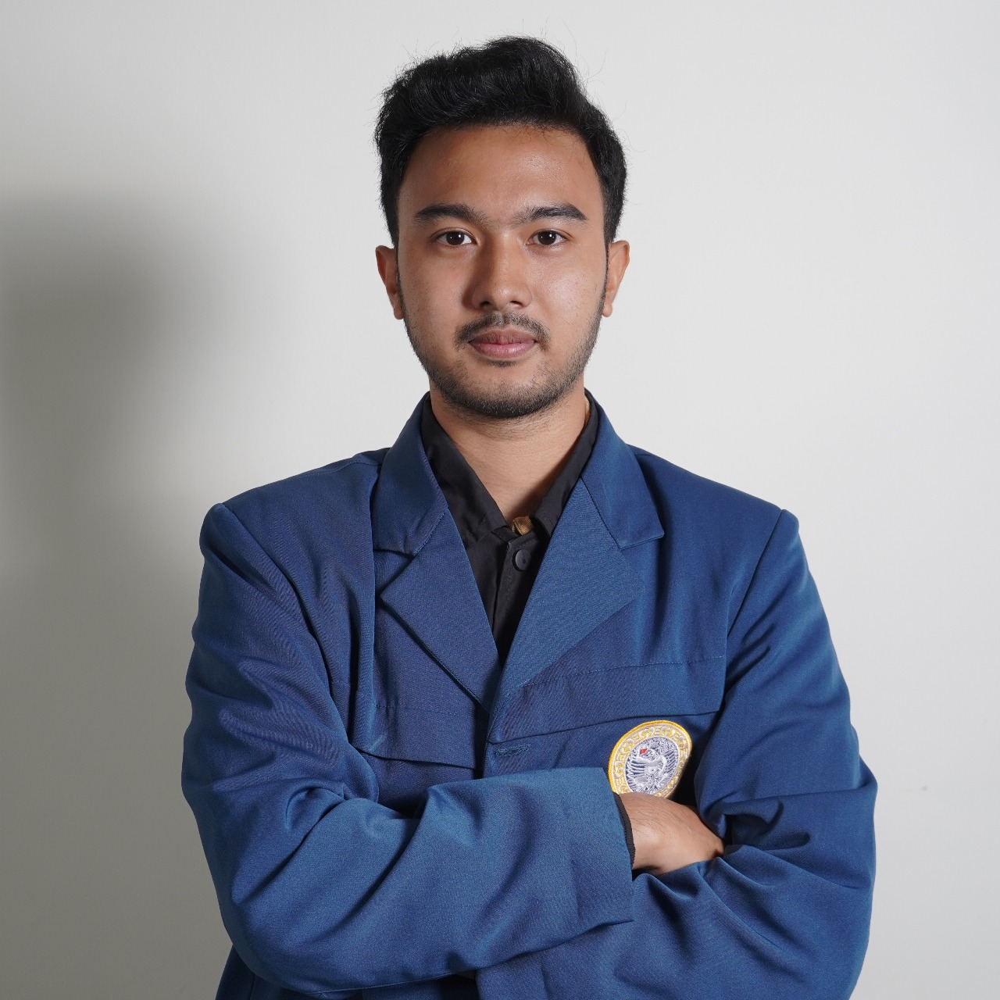

✓ Image loaded: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg

PREDICTING CLUSTER
Processing image: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg
Validating image: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg
File size: 305408 bytes
✓ Image opened successfully
  Format: JPEG
  Mode: RGB
  Size: (1280, 1280)
✓ Fixed image saved to: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548_fixed.jpg
Loading image: C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548_fixed.jpg
Method 1: Loading with OpenCV...
✓ OpenCV loaded successfully, shape: (1280, 1280, 3), dtype: uint8
  Trying HOG face detection...
  HOG detection failed: Unsupported image type, must be 8bit gray or RGB image.
  Trying HOG with upsampling...
  HOG upsampled detection failed: Unsupported image type, m

In [1]:
import joblib
import os
import numpy as np
import cv2
import face_recognition
from PIL import Image, ImageEnhance
from IPython.display import display
import pickle
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

class ModelLoader:
    """
    Class to load and use the saved dating app models
    """
    def __init__(self, model_path):
        self.model_path = Path(model_path)
        self.scaler = None
        self.dimensionality_reducer = None
        self.kmeans = None
        self.cluster_centers = None
        self.n_clusters = None
        self.n_components = None
        self.processed_features = None
        self.image_paths = None
        self.cluster_labels = None
        self.model_data = None  # Store the full model data
        
    def load_models(self):
        """
        Load all the saved models and data
        """
        try:
            # Load the model file
            self.model_data = joblib.load(self.model_path)
            print(f"Loaded data type: {type(self.model_data)}")
            print(f"Data keys: {list(self.model_data.keys()) if isinstance(self.model_data, dict) else 'Not a dictionary'}")
            
            # Handle your specific model structure
            if isinstance(self.model_data, dict):
                # Extract the final model (this should be your trained clustering model)
                if 'final_model' in self.model_data:
                    self.kmeans = self.model_data['final_model']
                    print(f"Final model type: {type(self.kmeans)}")
                
                # Extract cluster labels
                if 'final_labels' in self.model_data:
                    self.cluster_labels = self.model_data['final_labels']
                    print(f"Cluster labels shape: {np.array(self.cluster_labels).shape}")
                
                # Extract feature info
                if 'feature_info' in self.model_data:
                    feature_info = self.model_data['feature_info']
                    print(f"Feature info: {feature_info}")
                
                # Extract best features
                if 'best_features' in self.model_data:
                    self.processed_features = self.model_data['best_features']
                    print(f"Best features shape: {np.array(self.processed_features).shape}")
                
                # Extract configuration
                if 'best_configuration' in self.model_data:
                    config = self.model_data['best_configuration']
                    print(f"Best configuration: {config}")
                    
                    # Extract number of clusters from configuration
                    if 'n_clusters' in config:
                        self.n_clusters = config['n_clusters']
                
                # Extract dimensionality reduction info
                if 'dimensionality_reduction' in self.model_data:
                    dim_red_info = self.model_data['dimensionality_reduction']
                    print(f"Dimensionality reduction info: {dim_red_info}")
                    
                    # If there's a reducer model saved
                    if isinstance(dim_red_info, dict) and 'reducer' in dim_red_info:
                        self.dimensionality_reducer = dim_red_info['reducer']
                    elif hasattr(dim_red_info, 'transform'):
                        self.dimensionality_reducer = dim_red_info
                
                # Extract metadata
                if 'metadata' in self.model_data:
                    metadata = self.model_data['metadata']
                    print(f"Metadata: {metadata}")
                
                # Try to extract scaler if it exists in the model
                if hasattr(self.kmeans, 'named_steps'):
                    # If it's a pipeline
                    steps = self.kmeans.named_steps
                    print(f"Pipeline steps: {list(steps.keys())}")
                    
                    if 'scaler' in steps:
                        self.scaler = steps['scaler']
                    if 'pca' in steps:
                        self.dimensionality_reducer = steps['pca']
                    if 'kmeans' in steps:
                        self.kmeans = steps['kmeans']
                
                # Get cluster centers if available
                if hasattr(self.kmeans, 'cluster_centers_'):
                    self.cluster_centers = self.kmeans.cluster_centers_
                    self.n_clusters = len(self.cluster_centers)
                
            print("\n" + "="*50)
            print("MODEL LOADING SUMMARY")
            print("="*50)
            print(f"   Scaler: {'✓' if self.scaler else '✗'}")
            print(f"   Dimensionality Reducer: {'✓' if self.dimensionality_reducer else '✗'}")
            print(f"   K-Means: {'✓' if self.kmeans else '✗'}")
            print(f"   Processed Features: {'✓' if self.processed_features is not None else '✗'}")
            print(f"   Number of Clusters: {self.n_clusters}")
            print(f"   Cluster Centers Shape: {self.cluster_centers.shape if self.cluster_centers is not None else 'None'}")
            
            return True
            
        except Exception as e:
            print(f"❌ Error loading models: {e}")
            import traceback
            traceback.print_exc()
            return False
    
    def validate_and_fix_image(self, image_path, output_path=None):
        """
        Validate and potentially fix image file issues
        """
        try:
            print(f"Validating image: {image_path}")
            
            # Check file existence
            if not os.path.exists(image_path):
                print(f"❌ File does not exist: {image_path}")
                return None
            
            # Check file size
            file_size = os.path.getsize(image_path)
            print(f"File size: {file_size} bytes")
            
            if file_size == 0:
                print("❌ File is empty")
                return None
            
            # Try to open and validate the image
            with Image.open(image_path) as img:
                print(f"✓ Image opened successfully")
                print(f"  Format: {img.format}")
                print(f"  Mode: {img.mode}")
                print(f"  Size: {img.size}")
                
                # Convert to RGB if needed
                if img.mode != 'RGB':
                    print(f"Converting from {img.mode} to RGB")
                    img = img.convert('RGB')
                
                # Save fixed version if output path provided
                if output_path:
                    img.save(output_path, 'JPEG', quality=95)
                    print(f"✓ Fixed image saved to: {output_path}")
                    return output_path
                else:
                    # Save temporary fixed version
                    temp_path = str(image_path).replace('.jpg', '_fixed.jpg').replace('.jpeg', '_fixed.jpg').replace('.png', '_fixed.jpg')
                    img.save(temp_path, 'JPEG', quality=95)
                    print(f"✓ Fixed image saved to: {temp_path}")
                    return temp_path
                    
        except Exception as e:
            print(f"❌ Image validation failed: {e}")
            print(f"Error type: {type(e)._name_}")
            return None
    
    def preprocess_image(self, image_path, target_size=(512, 512), quality_threshold=50):
        """
        Preprocess single image (same as in training)
        """
        try:
            with Image.open(image_path) as img:
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                         
                width, height = img.size
                
                # Handle small images with upscaling
                if width < quality_threshold or height < quality_threshold:
                    scale_factor = max(quality_threshold / width, quality_threshold / height)
                    new_width = int(width * scale_factor * 1.1)
                    new_height = int(height * scale_factor * 1.1)
                    img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)
                         
                # Enhance image quality
                enhancer = ImageEnhance.Contrast(img)
                img = enhancer.enhance(1.1)
                enhancer = ImageEnhance.Sharpness(img)
                img = enhancer.enhance(1.1)
                         
                # Resize while maintaining aspect ratio
                img.thumbnail(target_size, Image.Resampling.LANCZOS)
                         
                # Center on white background
                processed_img = Image.new('RGB', target_size, (255, 255, 255))
                x = (target_size[0] - img.width) // 2
                y = (target_size[1] - img.height) // 2
                processed_img.paste(img, (x, y))
                         
                return processed_img
        except Exception as e:
            print(f"Error processing {image_path}: {e}")
            return None

    def extract_face_encodings(self, image_path, model="hog", num_jitters=1):
        """
        Extract face encodings with improved image handling and multiple fallback methods
        """
        try:
            print(f"Loading image: {image_path}")
            
            # Check if file exists
            if not os.path.exists(image_path):
                print(f"❌ Image file not found: {image_path}")
                return []
            
            # Method 1: Load with OpenCV first (most reliable for face_recognition)
            print("Method 1: Loading with OpenCV...")
            try:
                cv_image = cv2.imread(str(image_path))
                if cv_image is not None:
                    # Convert BGR to RGB
                    image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
                    
                    # Ensure the image is in the correct format
                    if image.dtype != np.uint8:
                        print(f"Converting image dtype from {image.dtype} to uint8")
                        image = image.astype(np.uint8)
                    
                    print(f"✓ OpenCV loaded successfully, shape: {image.shape}, dtype: {image.dtype}")
                    
                    # Test with face_recognition
                    face_locations = self._detect_faces_with_fallbacks(image)
                    if face_locations:
                        face_encodings = face_recognition.face_encodings(image, face_locations, num_jitters=num_jitters)
                        print(f"✓ Method 1 successful: {len(face_encodings)} face encodings extracted")
                        return face_encodings
                    else:
                        print("Method 1: No faces detected")
                        
            except Exception as e:
                print(f"Method 1 (OpenCV) failed: {e}")
            
            # Method 2: PIL with specific conversion
            print("Method 2: Loading with PIL...")
            try:
                with Image.open(image_path) as pil_image:
                    # Convert to RGB if necessary
                    if pil_image.mode != 'RGB':
                        print(f"Converting PIL image from {pil_image.mode} to RGB")
                        pil_image = pil_image.convert('RGB')
                    
                    # Convert to numpy array with explicit dtype
                    image = np.array(pil_image, dtype=np.uint8)
                    
                    # Ensure it's contiguous in memory
                    if not image.flags['C_CONTIGUOUS']:
                        print("Making image contiguous in memory")
                        image = np.ascontiguousarray(image)
                    
                    print(f"✓ PIL loaded successfully, shape: {image.shape}, dtype: {image.dtype}")
                    
                    # Test with face_recognition
                    face_locations = self._detect_faces_with_fallbacks(image)
                    if face_locations:
                        face_encodings = face_recognition.face_encodings(image, face_locations, num_jitters=num_jitters)
                        print(f"✓ Method 2 successful: {len(face_encodings)} face encodings extracted")
                        return face_encodings
                    else:
                        print("Method 2: No faces detected")
                        
            except Exception as e:
                print(f"Method 2 (PIL) failed: {e}")
            
            # Method 3: Try with image resizing (sometimes helps)
            print("Method 3: Trying with resized image...")
            try:
                with Image.open(image_path) as pil_image:
                    if pil_image.mode != 'RGB':
                        pil_image = pil_image.convert('RGB')
                    
                    # Resize if too large (can cause memory issues)
                    if pil_image.size[0] > 1024 or pil_image.size[1] > 1024:
                        print(f"Resizing large image from {pil_image.size}")
                        pil_image.thumbnail((1024, 1024), Image.Resampling.LANCZOS)
                    
                    image = np.array(pil_image, dtype=np.uint8)
                    image = np.ascontiguousarray(image)
                    
                    print(f"✓ Resized image loaded, shape: {image.shape}, dtype: {image.dtype}")
                    
                    face_locations = self._detect_faces_with_fallbacks(image)
                    if face_locations:
                        face_encodings = face_recognition.face_encodings(image, face_locations, num_jitters=num_jitters)
                        print(f"✓ Method 3 successful: {len(face_encodings)} face encodings extracted")
                        return face_encodings
                    else:
                        print("Method 3: No faces detected")
                        
            except Exception as e:
                print(f"Method 3 (Resized) failed: {e}")
            
            # Method 4: Try saving and reloading as JPEG (fixes some format issues)
            print("Method 4: Converting to JPEG format...")
            try:
                temp_path = str(image_path).replace(os.path.splitext(image_path)[1], '_temp.jpg')
                
                with Image.open(image_path) as pil_image:
                    if pil_image.mode != 'RGB':
                        pil_image = pil_image.convert('RGB')
                    
                    # Save as JPEG
                    pil_image.save(temp_path, 'JPEG', quality=95)
                
                # Load the JPEG version
                cv_image = cv2.imread(temp_path)
                if cv_image is not None:
                    image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
                    image = image.astype(np.uint8)
                    
                    print(f"✓ JPEG conversion successful, shape: {image.shape}, dtype: {image.dtype}")
                    
                    face_locations = self._detect_faces_with_fallbacks(image)
                    if face_locations:
                        face_encodings = face_recognition.face_encodings(image, face_locations, num_jitters=num_jitters)
                        print(f"✓ Method 4 successful: {len(face_encodings)} face encodings extracted")
                        
                        # Clean up temp file
                        try:
                            os.remove(temp_path)
                        except:
                            pass
                        
                        return face_encodings
                    else:
                        print("Method 4: No faces detected")
                
                # Clean up temp file
                try:
                    os.remove(temp_path)
                except:
                    pass
                    
            except Exception as e:
                print(f"Method 4 (JPEG conversion) failed: {e}")
            
            print("❌ All methods failed - no faces detected")
            return []
            
        except Exception as e:
            print(f"❌ Critical error in face encoding extraction: {e}")
            import traceback
            traceback.print_exc()
            return []

    def _detect_faces_with_fallbacks(self, image):
        """
        Try multiple face detection methods with fallbacks
        """
        face_locations = []
        
        # Method 1: HOG (faster)
        try:
            print("  Trying HOG face detection...")
            face_locations = face_recognition.face_locations(image, model="hog", number_of_times_to_upsample=0)
            if face_locations:
                print(f"  ✓ HOG found {len(face_locations)} faces")
                return face_locations
        except Exception as e:
            print(f"  HOG detection failed: {e}")
        
        # Method 2: HOG with upsampling
        try:
            print("  Trying HOG with upsampling...")
            face_locations = face_recognition.face_locations(image, model="hog", number_of_times_to_upsample=1)
            if face_locations:
                print(f"  ✓ HOG (upsampled) found {len(face_locations)} faces")
                return face_locations
        except Exception as e:
            print(f"  HOG upsampled detection failed: {e}")
        
        # Method 3: CNN (more accurate but slower)
        try:
            print("  Trying CNN face detection...")
            face_locations = face_recognition.face_locations(image, model="cnn", number_of_times_to_upsample=0)
            if face_locations:
                print(f"  ✓ CNN found {len(face_locations)} faces")
                return face_locations
        except Exception as e:
            print(f"  CNN detection failed: {e}")
        
        return face_locations

    def extract_additional_features(self, image_path):
        """
        Extract additional features (same as in training)
        """
        try:
            img = cv2.imread(str(image_path))
            if img is None:
                return np.array([])
                
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4, minSize=(30, 30))
            
            additional_features = []
            
            if len(faces) > 0:
                face = max(faces, key=lambda x: x[2] * x[3])
                x, y, w, h = face
                
                padding = 10
                y1 = max(0, y - padding)
                y2 = min(gray.shape[0], y + h + padding)
                x1 = max(0, x - padding)
                x2 = min(gray.shape[1], x + w + padding)
                
                face_roi = gray[y1:y2, x1:x2]
                
                if face_roi.size > 0:
                    aspect_ratio = w / h
                    face_area = w * h
                    
                    img_height, img_width = gray.shape
                    normalized_area = face_area / (img_width * img_height)
                    
                    face_resized = cv2.resize(face_roi, (64, 64))
                    
                    hist = cv2.calcHist([face_resized], [0], None, [16], [0, 256])
                    hist = hist.flatten() / (np.sum(hist) + 1e-7)
                    
                    grad_x = cv2.Sobel(face_resized, cv2.CV_64F, 1, 0, ksize=3)
                    grad_y = cv2.Sobel(face_resized, cv2.CV_64F, 0, 1, ksize=3)
                    gradient_magnitude = np.sqrt(grad_x*2 + grad_y*2)
                    
                    grad_mean = np.mean(gradient_magnitude)
                    grad_std = np.std(gradient_magnitude)
                    
                    edges = cv2.Canny(face_resized, 50, 150)
                    edge_density = np.sum(edges > 0) / edges.size
                    
                    additional_features = [
                        aspect_ratio, normalized_area, grad_mean, grad_std, edge_density
                    ] + hist.tolist()
                    
            return np.array(additional_features) if additional_features else np.array([])
            
        except Exception as e:
            print(f"Error extracting additional features from {image_path}: {e}")
            return np.array([])
    
    def predict_cluster(self, image_path, return_confidence=False):
        """
        Predict cluster for a new image
        """
        try:
            print(f"Processing image: {image_path}")
            
            # First validate and potentially fix the image
            fixed_image_path = self.validate_and_fix_image(image_path)
            if fixed_image_path is None:
                print("❌ Image validation failed")
                return None
            
            # Use fixed image path if different from original
            working_image_path = fixed_image_path if fixed_image_path != image_path else image_path
            
            # Extract face encodings
            face_encodings = self.extract_face_encodings(working_image_path)
            
            if not face_encodings:
                print("❌ No faces detected in the image")
                
                # Clean up temporary file if created
                if fixed_image_path != image_path and os.path.exists(fixed_image_path):
                    try:
                        os.remove(fixed_image_path)
                        print("Cleaned up temporary file")
                    except:
                        pass
                
                return None
            
            print(f"✓ Found {len(face_encodings)} face(s)")
            
            # Extract additional features
            additional_features = self.extract_additional_features(working_image_path)
            print(f"✓ Extracted additional features: {len(additional_features)} dimensions")
            
            # Clean up temporary file if created
            if fixed_image_path != image_path and os.path.exists(fixed_image_path):
                try:
                    os.remove(fixed_image_path)
                    print("Cleaned up temporary file")
                except:
                    pass
            
            # Combine features
            face_encoding = face_encodings[0]  # Use first face
            
            if len(additional_features) > 0 and self.processed_features is not None:
                # Match the feature dimensions from training
                expected_additional_len = self.processed_features.shape[1] - 128  # 128 is face encoding length
                
                if len(additional_features) < expected_additional_len:
                    additional_features = np.pad(additional_features, 
                                               (0, expected_additional_len - len(additional_features)), 
                                               'constant')
                elif len(additional_features) > expected_additional_len:
                    additional_features = additional_features[:expected_additional_len]
                
                combined_features = np.hstack([face_encoding, additional_features])
            else:
                combined_features = face_encoding
            
            print(f"✓ Combined features shape: {combined_features.shape}")
            
            # Apply preprocessing based on what's available in the model
            features_to_use = combined_features.reshape(1, -1)  # Reshape for prediction
            
            # Check if the model is a pipeline
            if hasattr(self.kmeans, 'predict'):
                # Direct prediction
                cluster = self.kmeans.predict(features_to_use)[0]
                print(f"✓ Predicted cluster: {cluster}")
                
                if return_confidence and hasattr(self.kmeans, 'transform'):
                    # Calculate distance to cluster center
                    distances = self.kmeans.transform(features_to_use)[0]
                    min_distance = np.min(distances)
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                elif return_confidence and self.cluster_centers is not None:
                    # Calculate distance manually
                    distances = np.linalg.norm(features_to_use - self.cluster_centers, axis=1)
                    min_distance = distances[cluster]
                    max_distance = np.max(distances)
                    confidence = 1 - (min_distance / (max_distance + 1e-7))
                    
                    return {
                        'cluster': int(cluster),
                        'confidence': float(confidence),
                        'distance_to_center': float(min_distance)
                    }
                else:
                    return int(cluster)
            else:
                print("❌ Model doesn't have predict method")
                return None
                
        except Exception as e:
            print(f"❌ Error during prediction: {e}")
            import traceback
            traceback.print_exc()
            return None

    def inspect_model_structure(self):
        """
        Inspect and print the structure of the loaded model
        """
        print("\n" + "="*50)
        print("MODEL STRUCTURE INSPECTION")
        print("="*50)
        
        if self.model_data:
            for key, value in self.model_data.items():
                print(f"\n{key}:")
                print(f"  Type: {type(value)}")
                
                if isinstance(value, np.ndarray):
                    print(f"  Shape: {value.shape}")
                    print(f"  Dtype: {value.dtype}")
                elif isinstance(value, list):
                    print(f"  Length: {len(value)}")
                    if len(value) > 0:
                        print(f"  First element type: {type(value[0])}")
                elif isinstance(value, dict):
                    print(f"  Keys: {list(value.keys())}")
                elif hasattr(value, '_dict_'):
                    print(f"  Attributes: {list(value._dict_.keys())}")
                
                # Print a sample of the data if it's small enough
                if isinstance(value, (int, float, str, bool)):
                    print(f"  Value: {value}")
                elif isinstance(value, np.ndarray) and value.size < 20:
                    print(f"  Values: {value}")
                elif isinstance(value, list) and len(value) < 20:
                    print(f"  Values: {value}")


# Updated usage code
def main():
    # 1. Import and setup
    model_gender = 'male'  # atau 'female'
    model_path = r'C:\Machine Learning\flask-uas-ml\static\models\kmeans_clustering_pipeline_20250612_093108.pkl'
    image_path = r'C:\Machine Learning\flask-uas-ml\static\img\WhatsApp Image 2025-06-12 at 15.14.28_4a943548.jpg'
    
    # 2. Load and inspect the model file
    print("="*50)
    print("LOADING MODEL")
    print("="*50)
    
    if not os.path.exists(model_path):
        print(f"[ERROR] Model not found at: {model_path}")
        return
    
    # 3. Create model loader
    loader = ModelLoader(model_path)
    
    # 4. Load models
    if not loader.load_models():
        print("Failed to load models!")
        return
    
    # 5. Inspect model structure (optional - for debugging)
    loader.inspect_model_structure()
    
    # 6. Display the image
    print("\n" + "="*50)
    print("DISPLAYING IMAGE")
    print("="*50)
    
    if os.path.exists(image_path):
        img = Image.open(image_path)
        display(img)
        print(f"✓ Image loaded: {image_path}")
    else:
        print(f"[ERROR] Image not found: {image_path}")
        return
    
    # 7. Predict cluster
    print("\n" + "="*50)
    print("PREDICTING CLUSTER")
    print("="*50)
    
    # Basic prediction
    predicted_cluster = loader.predict_cluster(image_path)
    if predicted_cluster is not None:
        print(f"[✓] Predicted Cluster ID: {predicted_cluster}")
    else:
        print("[✗] Prediction failed")
        return
    
    # Prediction with confidence
    detailed_result = loader.predict_cluster(image_path, return_confidence=True)
    if detailed_result:
        print(f"[✓] Detailed Result:")
        print(f"    Cluster: {detailed_result['cluster']}")
        print(f"    Confidence: {detailed_result['confidence']:.3f}")
        print(f"    Distance to Center: {detailed_result['distance_to_center']:.3f}")

if __name__ == "__main__":
    main()